In [1]:
import matplotlib.pyplot as plt
import numpy as np

In [43]:
x = np.arange(0, 5, 0.3)
noise = np.random.normal(0, 3, len(x))
y = np.power(x, 3) + np.power(x, 2) + noise**2
x_valid = np.arange(0, 5, 1)
noise = np.random.normal(0, 3, len(x_valid))

y_valid = np.power(x_valid, 3) + np.power(x_valid, 2) - noise

In [44]:
print(len(x))
print(len(y))
print(len(x_valid))
print(len(y_valid))


17
17
5
5


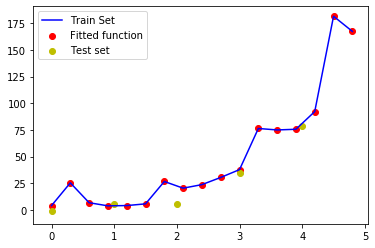

In [45]:
plt.scatter(x, y, c='r')
plt.plot(x, y, c='b')
plt.scatter(x_valid, y_valid, c='y')
plt.legend(['Train Set', 'Fitted function', 'Test set'], loc='upper left')  


In [31]:
print(noise)

[-0.85951594  0.35054598 -1.31228341 -0.03869551 -1.61577235  1.12141771
  0.40890054 -0.02461696 -0.77516162  1.27375593  1.96710175 -1.85798186
  1.23616403  1.62765075  0.3380117  -1.19926803  0.86334532 -0.1809203
 -0.60392063 -1.23005814  0.5505375   0.79280687 -0.62353073  0.52057634
 -1.14434139  0.80186103  0.0465673  -0.18656977 -0.10174587  0.86888616
  0.75041164  0.52946532  0.13770121  0.07782113]


In [47]:
from PIL import Image

In [49]:
image = Image.open("/Users/ravinkohli/Library/Mobile Documents/com~apple~CloudDocs/MSc Info/semester_3/instagram_seminar/data/images_test/050_kendalljenner81.jpg")
image.show()

In [72]:
import os
from os import listdir
from os.path import isfile, join
import pandas as pd
import numpy as np
import cv2
from typing import Union, Tuple, List
import matplotlib.pyplot as plt

In [73]:

def reshape_and_pad(image: np.ndarray, target_size: Union[List[int], Tuple[int]]):
    """
    reshape an image and pad it while keeping the ratio.
    :param image: image that shall be reshaped
    :param target_size: size of the target image
    :return: reshaped and padded image
    """
    # input shapes
    input_shape = image.shape[:2]
    # calculate the width and height
    w_ratio = float(target_size[1]) / input_shape[1]
    h_ratio = float(target_size[0]) / input_shape[0]
    # take the smaller ratio to ensure the whole image fits in the new shape
    ratio = min(w_ratio, h_ratio)
    # calculate the new size
    new_size = tuple([int(x * ratio) for x in input_shape])

    # resize the image
    scaled_image = cv2.resize(image, (new_size[1], new_size[0]))

    # width and height differences
    delta_w = target_size[1] - new_size[1]
    delta_h = target_size[0] - new_size[0]

    # image position within the new image
    top, bottom = delta_h // 2, delta_h - (delta_h // 2)
    left, right = delta_w // 2, delta_w - (delta_w // 2)

    # padding color
    padding_color = [0, 0, 0]
    new_image = cv2.copyMakeBorder(scaled_image, top, bottom, left, right, cv2.BORDER_CONSTANT, value=padding_color)

    return new_image

target_shape = [128, 128]


In [95]:
x = np.asarray(image)
scaled = reshape_and_pad(x, target_shape)
scaled_newaxis = scaled[np.newaxis, :]
import os
x_train = np.load("x_train.npy")
y_train = np.load("y_train.npy")


In [81]:
from TaskA.model import create_model
model = create_model(x_train.shape[1:])

In [82]:
model.load_weights("/Users/ravinkohli/Library/Mobile Documents/com~apple~CloudDocs/MSc Info/semester_3/instagram_seminar/models/model_1580383438.446045")


In [86]:
from keract import get_activations, display_activations, display_heatmaps

In [84]:
activations = get_activations(model, scaled, auto_compile=True)

conv2d_32 (1, 128, 128, 16) 


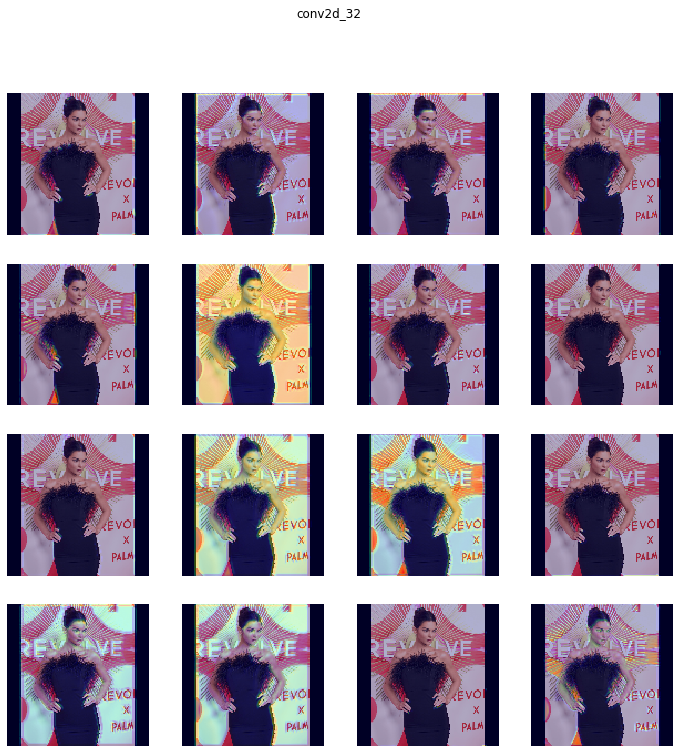

max_pooling2d_29 (1, 64, 64, 16) 


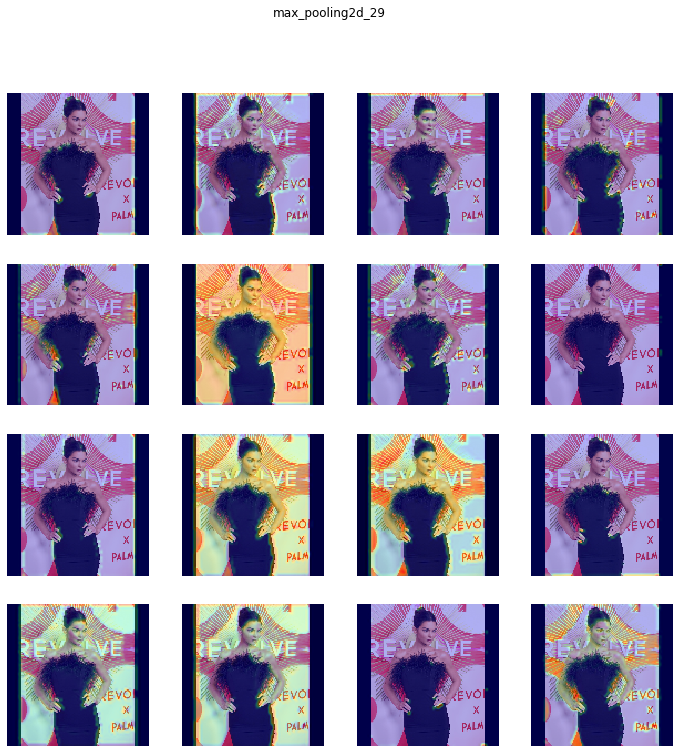

conv2d_33 (1, 64, 64, 16) 


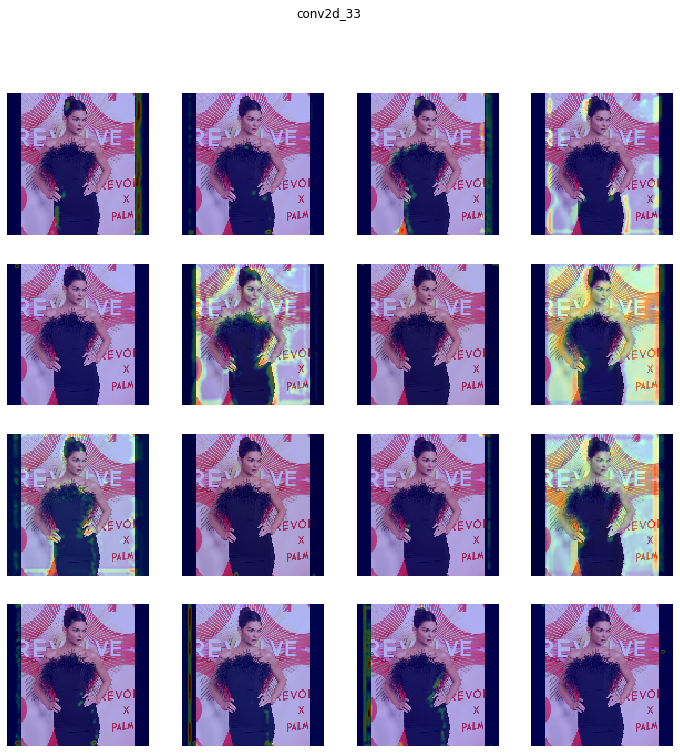

dropout_25 (1, 64, 64, 16) 


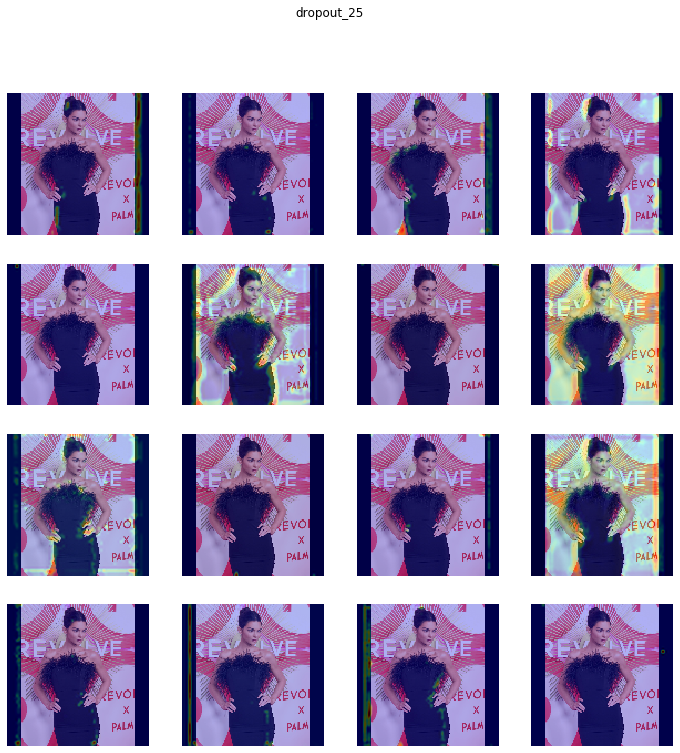

max_pooling2d_30 (1, 32, 32, 16) 


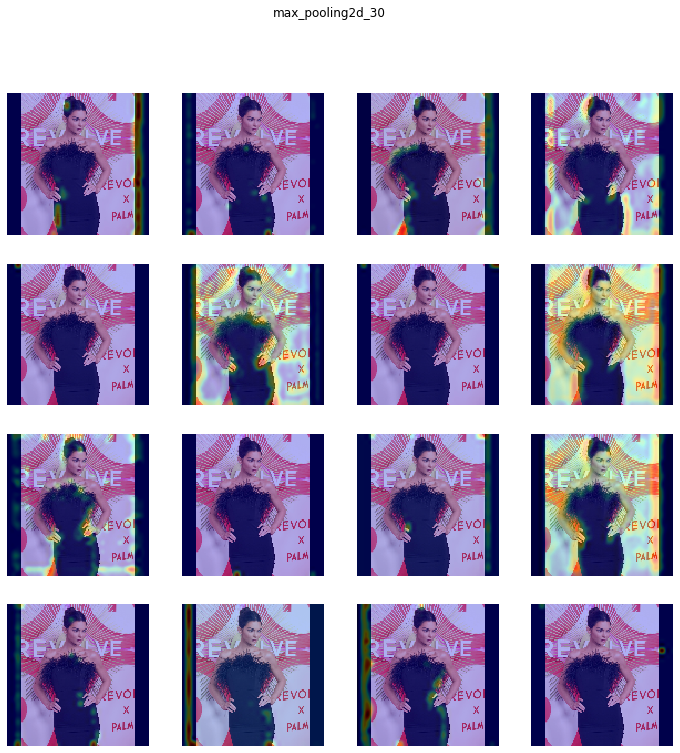

conv2d_34 (1, 32, 32, 16) 


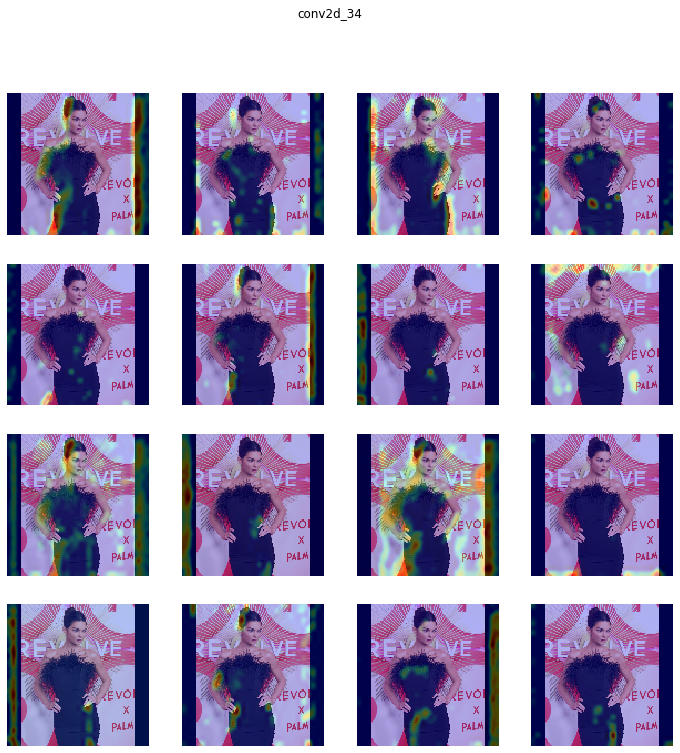

dropout_26 (1, 32, 32, 16) 


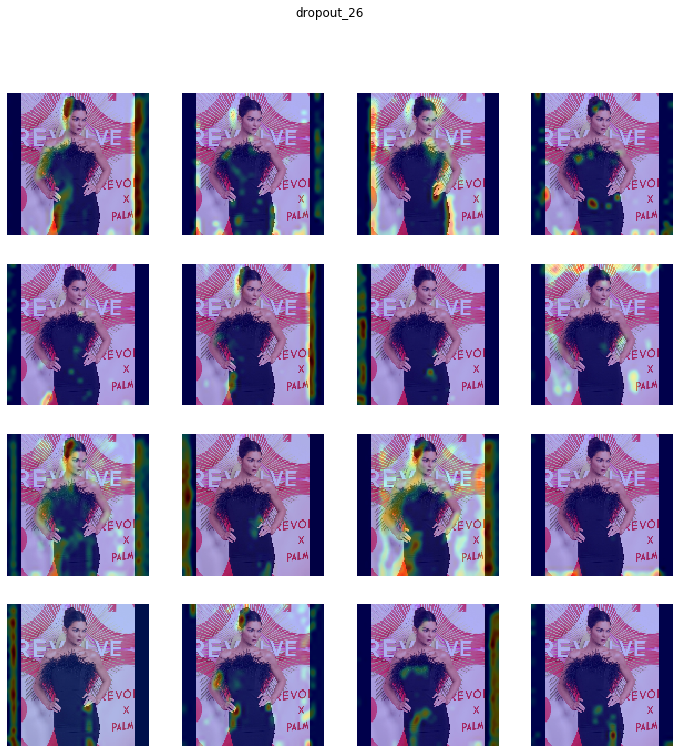

max_pooling2d_31 (1, 16, 16, 16) 


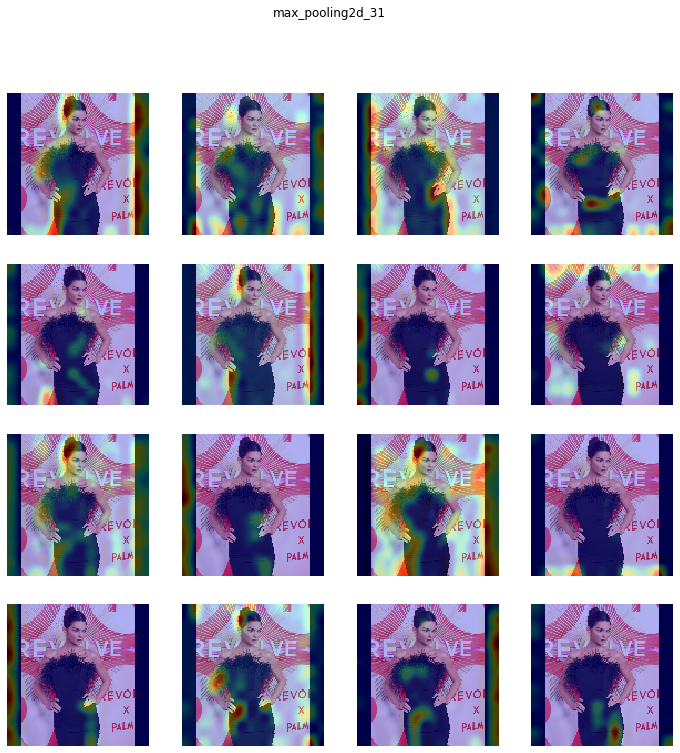

conv2d_35 (1, 16, 16, 16) 


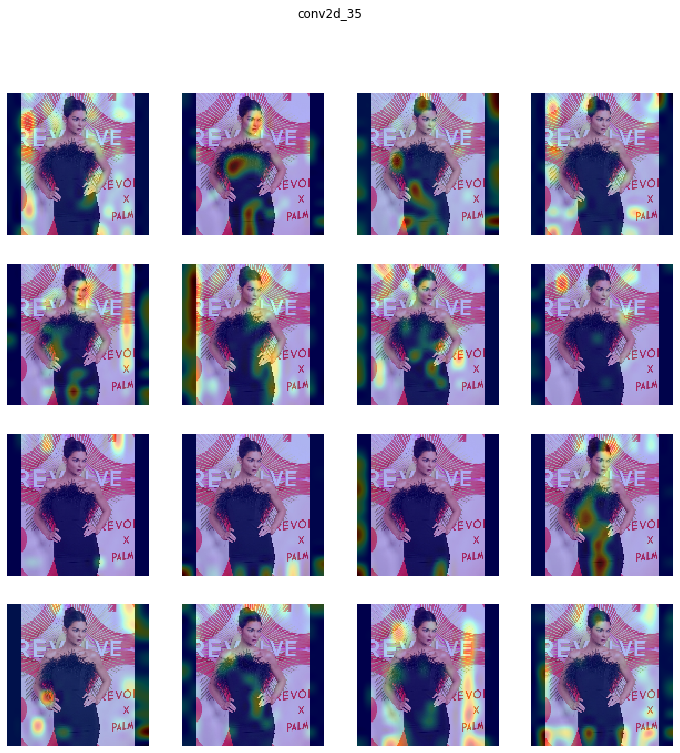

dropout_27 (1, 16, 16, 16) 


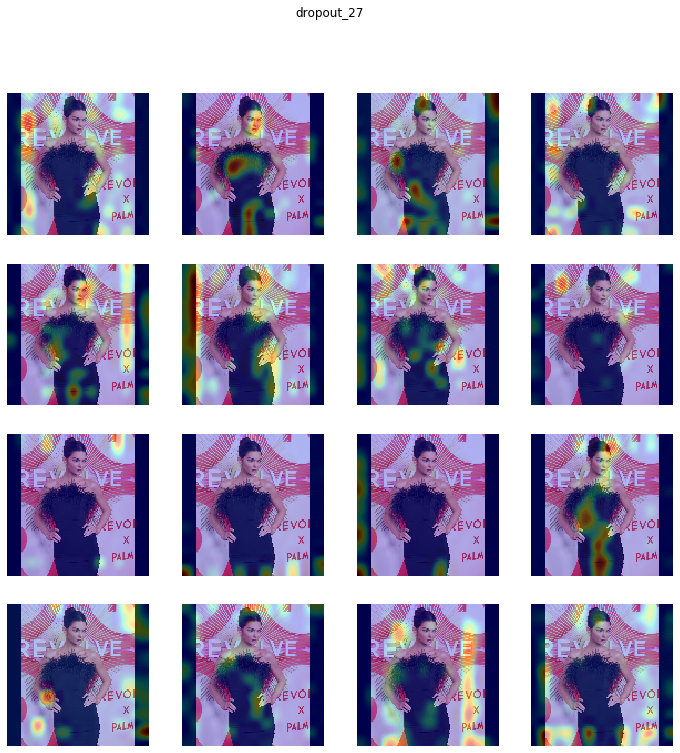

max_pooling2d_32 (1, 8, 8, 16) 


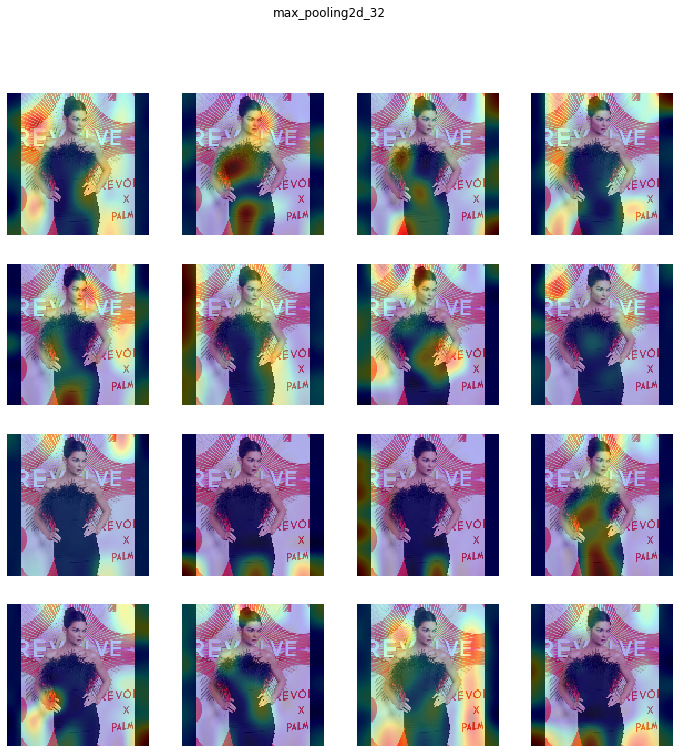

conv2d_36 (1, 8, 8, 16) 


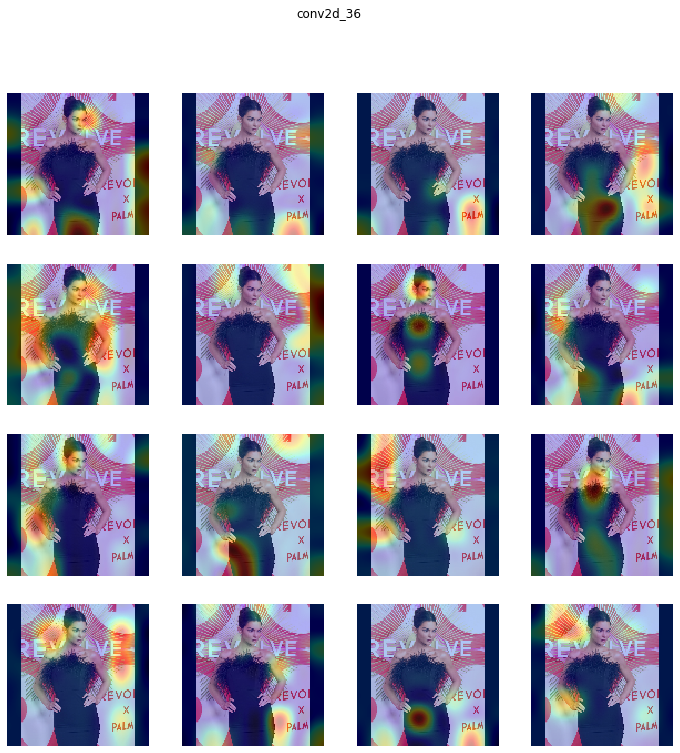

dropout_28 (1, 8, 8, 16) 


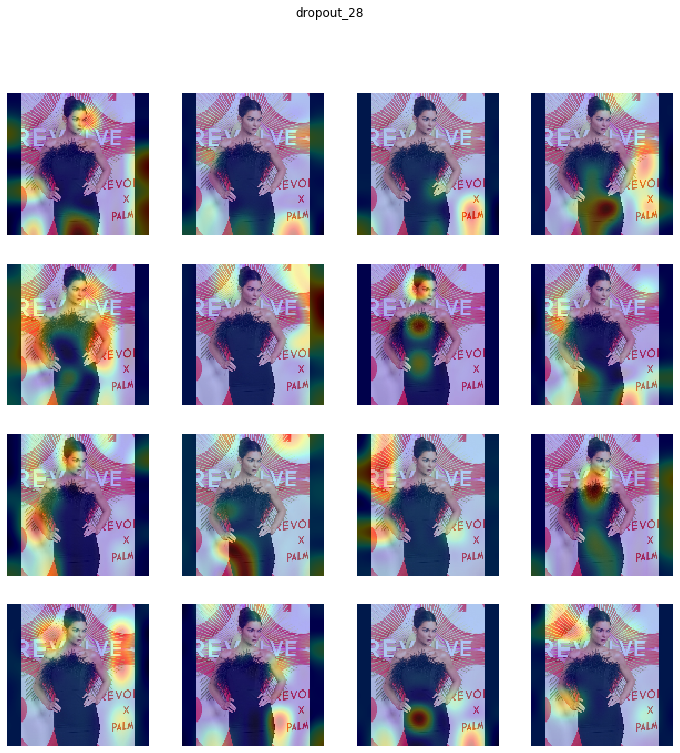

max_pooling2d_33 (1, 4, 4, 16) 


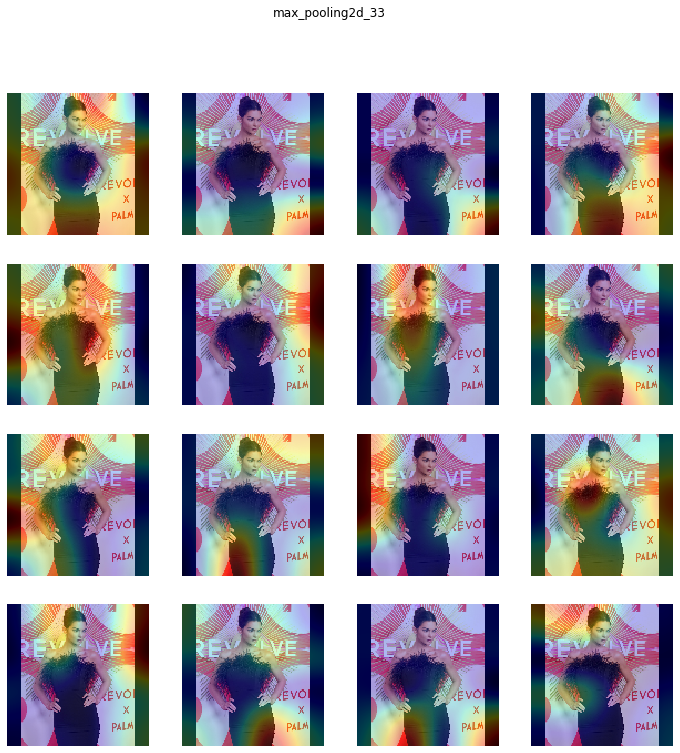

conv2d_37 (1, 4, 4, 16) 


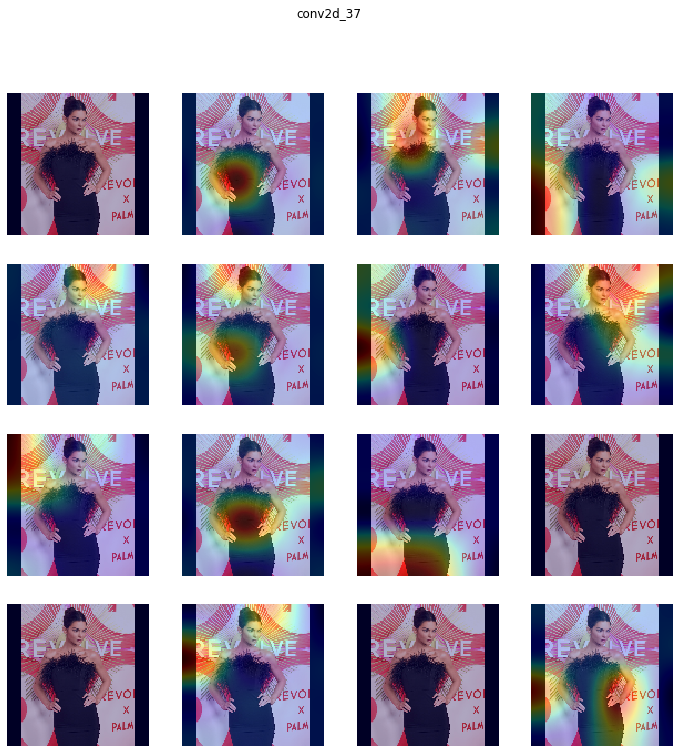

dropout_29 (1, 4, 4, 16) 


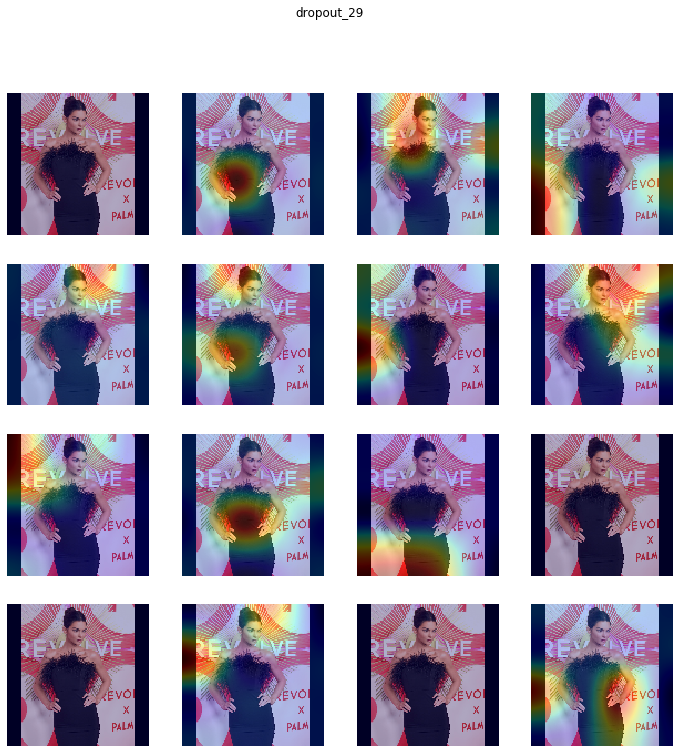

max_pooling2d_34 (1, 2, 2, 16) 


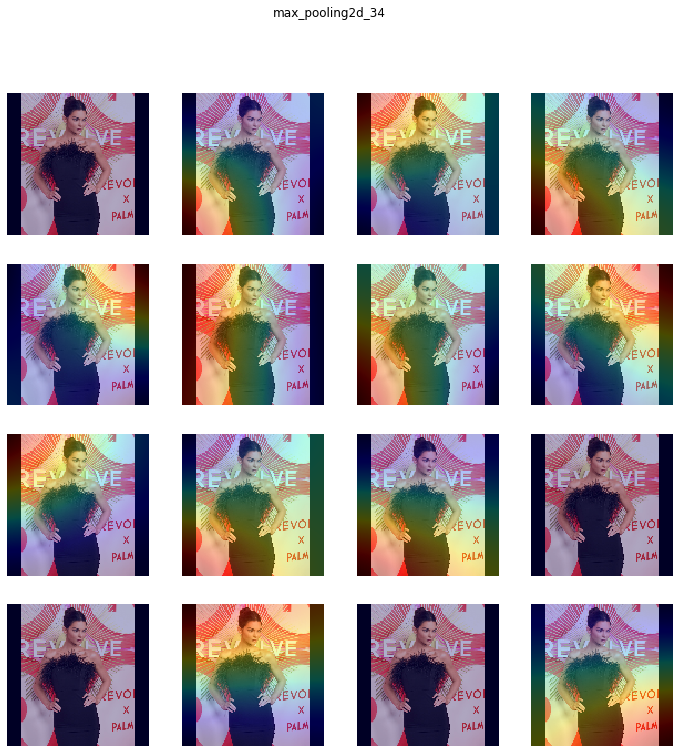

conv2d_38 (1, 2, 2, 16) 


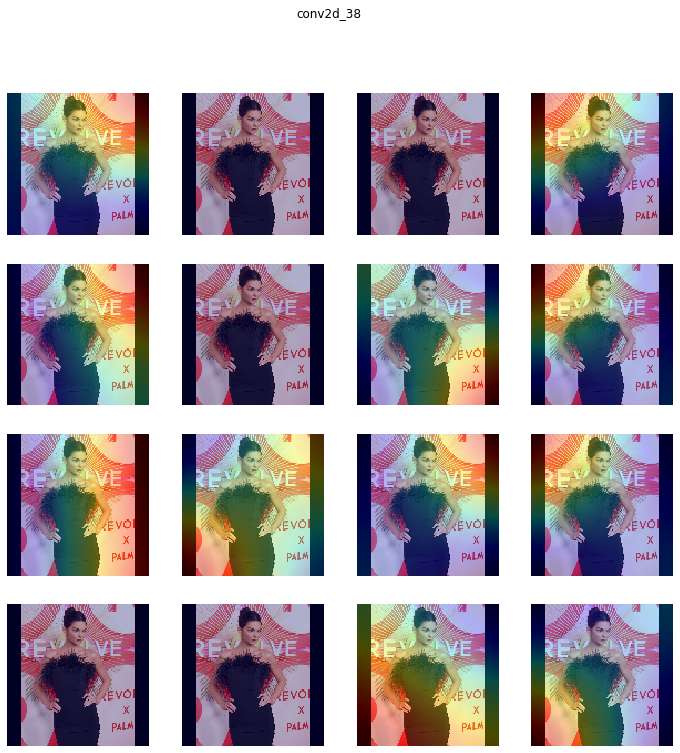

dropout_30 (1, 2, 2, 16) 


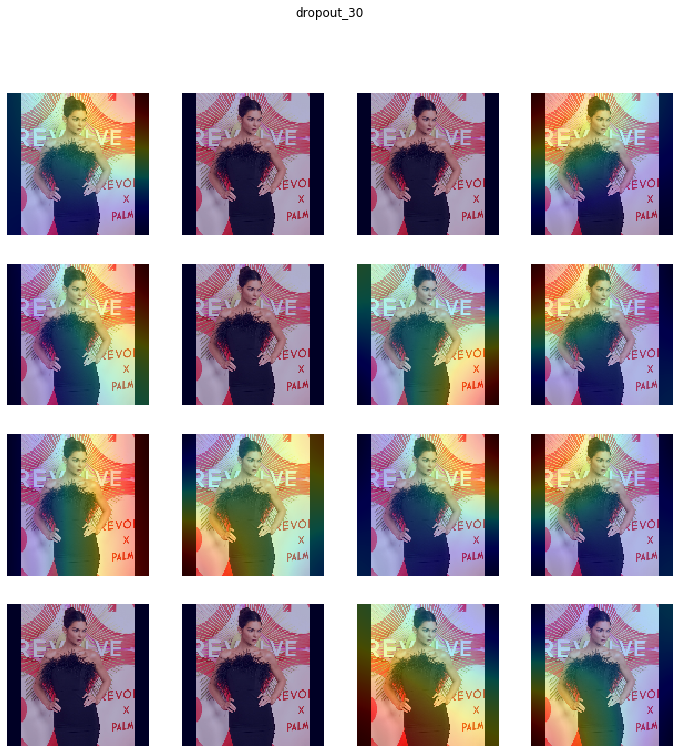

max_pooling2d_35 (1, 1, 1, 16) 


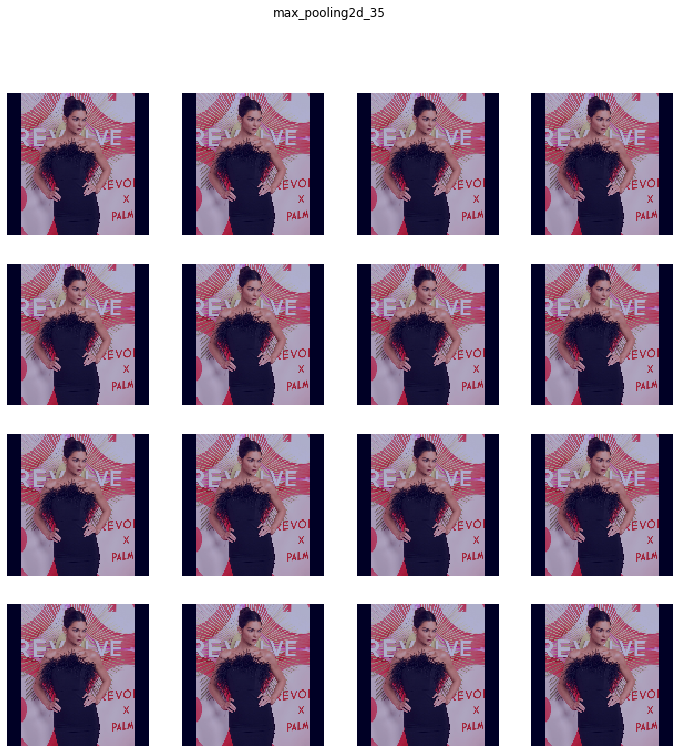

flatten_5 (1, 16) -> Skipped. 2D Activations.
dense_13 (1, 128) -> Skipped. 2D Activations.
dense_14 (1, 128) -> Skipped. 2D Activations.
dense_15 (1, 4) -> Skipped. 2D Activations.


In [88]:
display_heatmaps(activations, scaled)

In [89]:
layer_dict = dict([(layer.name, layer) for layer in model.layers])

In [117]:
from keras import backend as K

layer_name = 'conv2d_34'
filter_index = 4  # can be any integer from 0 to 511, as there are 512 filters in that layer
input_img= scaled
# build a loss function that maximizes the activation
# of the nth filter of the layer considered
print(layer_dict)
layer_output = layer_dict[layer_name].output
for k, v in layer_dict.items():
    print(k[:-3])

{'conv2d_32': <keras.layers.convolutional.Conv2D object at 0x1a54d7d390>, 'max_pooling2d_29': <keras.layers.pooling.MaxPooling2D object at 0x1a5542bc50>, 'conv2d_33': <keras.layers.convolutional.Conv2D object at 0x1a55471b50>, 'dropout_25': <keras.layers.core.Dropout object at 0x1a5537a150>, 'max_pooling2d_30': <keras.layers.pooling.MaxPooling2D object at 0x1a5e7fd9d0>, 'conv2d_34': <keras.layers.convolutional.Conv2D object at 0x1a54d54e50>, 'dropout_26': <keras.layers.core.Dropout object at 0x1a55381310>, 'max_pooling2d_31': <keras.layers.pooling.MaxPooling2D object at 0x1a54d54ed0>, 'conv2d_35': <keras.layers.convolutional.Conv2D object at 0x1a54d9bad0>, 'dropout_27': <keras.layers.core.Dropout object at 0x1a28d20550>, 'max_pooling2d_32': <keras.layers.pooling.MaxPooling2D object at 0x1a5549bbd0>, 'conv2d_36': <keras.layers.convolutional.Conv2D object at 0x1a55297350>, 'dropout_28': <keras.layers.core.Dropout object at 0x1a554b7ed0>, 'max_pooling2d_33': <keras.layers.pooling.MaxPooli

In [92]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_32 (Conv2D)           (None, 128, 128, 16)      1216      
_________________________________________________________________
max_pooling2d_29 (MaxPooling (None, 64, 64, 16)        0         
_________________________________________________________________
conv2d_33 (Conv2D)           (None, 64, 64, 16)        6416      
_________________________________________________________________
dropout_25 (Dropout)         (None, 64, 64, 16)        0         
_________________________________________________________________
max_pooling2d_30 (MaxPooling (None, 32, 32, 16)        0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 32, 32, 16)        6416      
_________________________________________________________________
dropout_26 (Dropout)         (None, 32, 32, 16)        0         
__________

In [119]:
model.predict(scaled_newaxis)

array([[1.1676683, 3.917008 , 4.5312686, 1.1317221]], dtype=float32)